## Load necessary modules

In [3]:
# show images inline
%matplotlib inline

# automatically reload modules when they have changed
%load_ext autoreload
%autoreload 2

# import keras
import keras

# import keras_retinanet
from keras_retinanet.models.resnet import custom_objects
from keras_retinanet.utils.image import read_image_bgr, preprocess_image, resize_image
from keras_retinanet.utils.visualization import draw_box, draw_caption
from keras_retinanet.utils.colors import label_color

# import miscellaneous modules
import matplotlib.pyplot as plt
import cv2
import os
import numpy as np
import time

# set tf backend to allow memory to grow, instead of claiming everything
import tensorflow as tf

def get_session():
    config = tf.ConfigProto()
    config.gpu_options.allow_growth = True
    return tf.Session(config=config)

# use this environment flag to change which GPU to use
#os.environ["CUDA_VISIBLE_DEVICES"] = "1"

# set the modified tf session as backend in keras
keras.backend.tensorflow_backend.set_session(get_session())

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Load RetinaNet model

In [14]:
# adjust this to point to your downloaded/trained model
model_path = os.path.join('/Users/nomanshafqat/Desktop/', 'resnet50_pascal_12.h5')

# load retinanet model
model = keras.models.load_model(model_path, custom_objects=custom_objects)
print(model.summary())

# load label to names mapping for visualization purposes
labels_to_names = {0: 'vehicle', 1: 'bicycle', 2: 'car', 3: 'motorcycle', 4: 'airplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket', 39: 'bottle', 40: 'wine glass', 41: 'cup', 42: 'fork', 43: 'knife', 44: 'spoon', 45: 'bowl', 46: 'banana', 47: 'apple', 48: 'sandwich', 49: 'orange', 50: 'broccoli', 51: 'carrot', 52: 'hot dog', 53: 'pizza', 54: 'donut', 55: 'cake', 56: 'chair', 57: 'couch', 58: 'potted plant', 59: 'bed', 60: 'dining table', 61: 'toilet', 62: 'tv', 63: 'laptop', 64: 'mouse', 65: 'remote', 66: 'keyboard', 67: 'cell phone', 68: 'microwave', 69: 'oven', 70: 'toaster', 71: 'sink', 72: 'refrigerator', 73: 'book', 74: 'clock', 75: 'vase', 76: 'scissors', 77: 'teddy bear', 78: 'hair drier', 79: 'toothbrush'}

/Users/nomanshafqat/anaconda/lib/python3.6/site-packages/keras/models.py:274: UserWarning: Output "clipped_boxes" missing from loss dictionary. We assume this was done on purpose, and we will not be expecting any data to be passed to "clipped_boxes" during training.
  sample_weight_mode=sample_weight_mode)
/Users/nomanshafqat/anaconda/lib/python3.6/site-packages/keras/models.py:274: UserWarning: Output "nms" missing from loss dictionary. We assume this was done on purpose, and we will not be expecting any data to be passed to "nms" during training.
  sample_weight_mode=sample_weight_mode)


__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, None, None, 3 0                                            
__________________________________________________________________________________________________
padding_conv1 (ZeroPadding2D)   (None, None, None, 3 0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1 (Conv2D)                  (None, None, None, 6 9408        padding_conv1[0][0]              
__________________________________________________________________________________________________
bn_conv1 (BatchNormalization)   (None, None, None, 6 256         conv1[0][0]                      
__________________________________________________________________________________________________
conv1_relu

## Run detection on example

00001124.png
/Users/nomanshafqat/Data/FYP/New/Images_val/00001124.png


processing time:  4.468636989593506


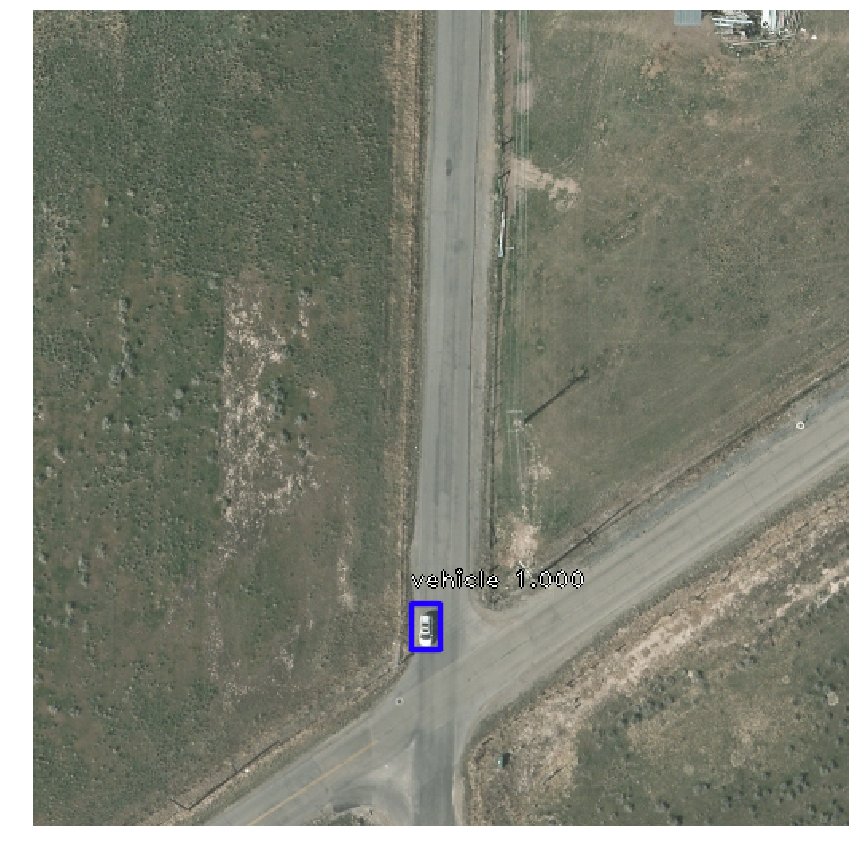

00001118.png
/Users/nomanshafqat/Data/FYP/New/Images_val/00001118.png


processing time:  3.9472362995147705


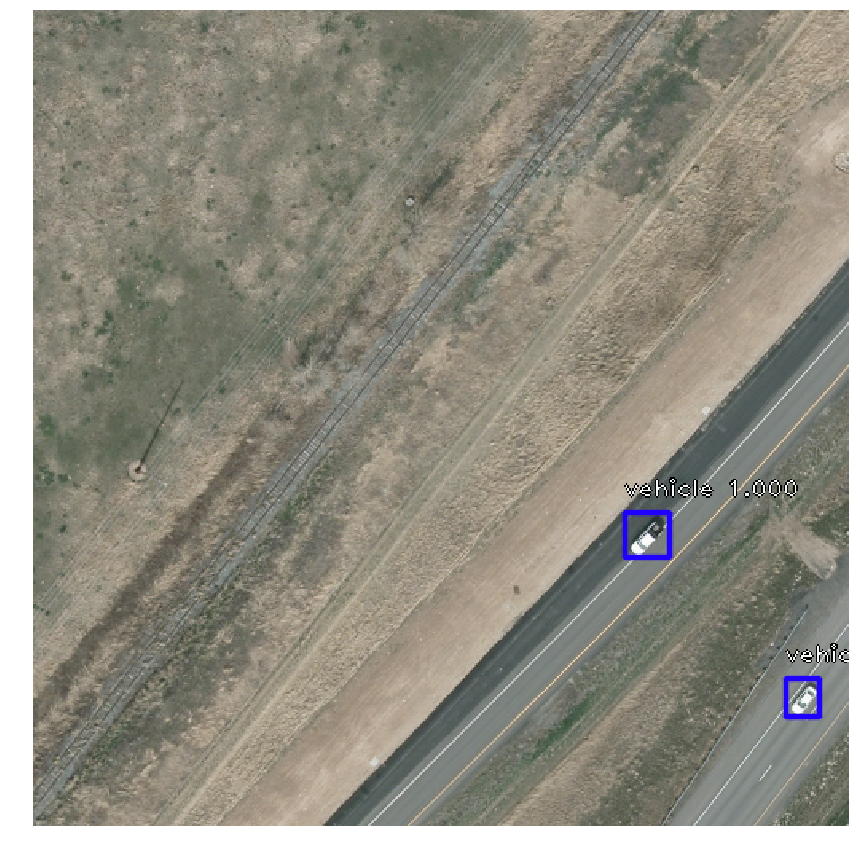

00000010.png
/Users/nomanshafqat/Data/FYP/New/Images_val/00000010.png


processing time:  3.726428270339966


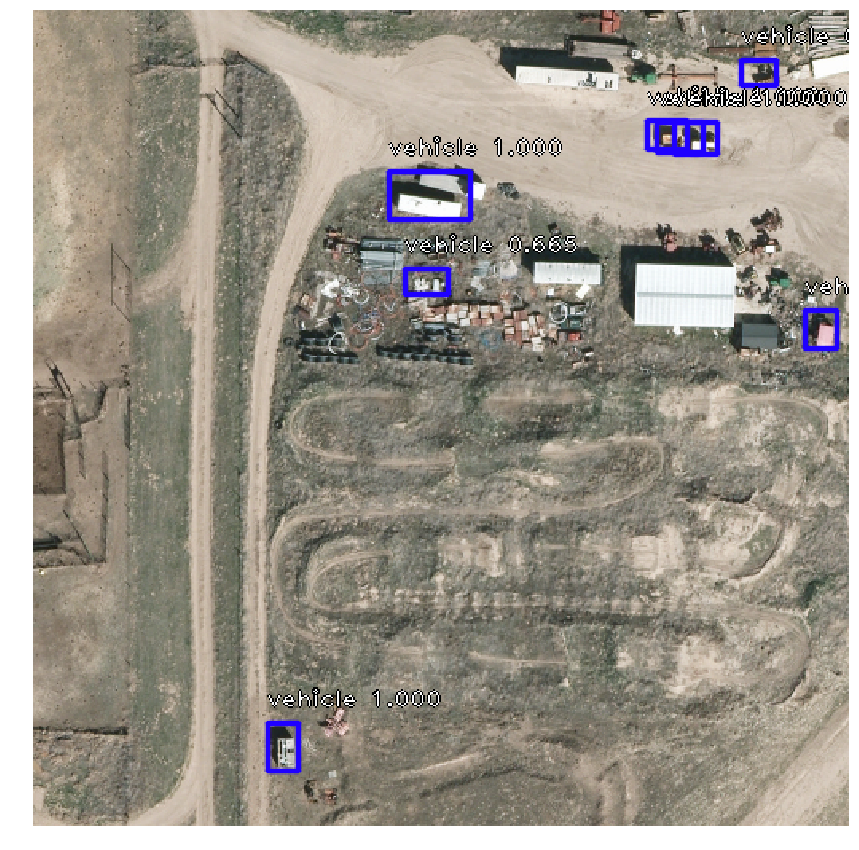

180_46946744_1025_2561_1281_2817.png
/Users/nomanshafqat/Data/FYP/New/Images_val/180_46946744_1025_2561_1281_2817.png


processing time:  3.9333832263946533


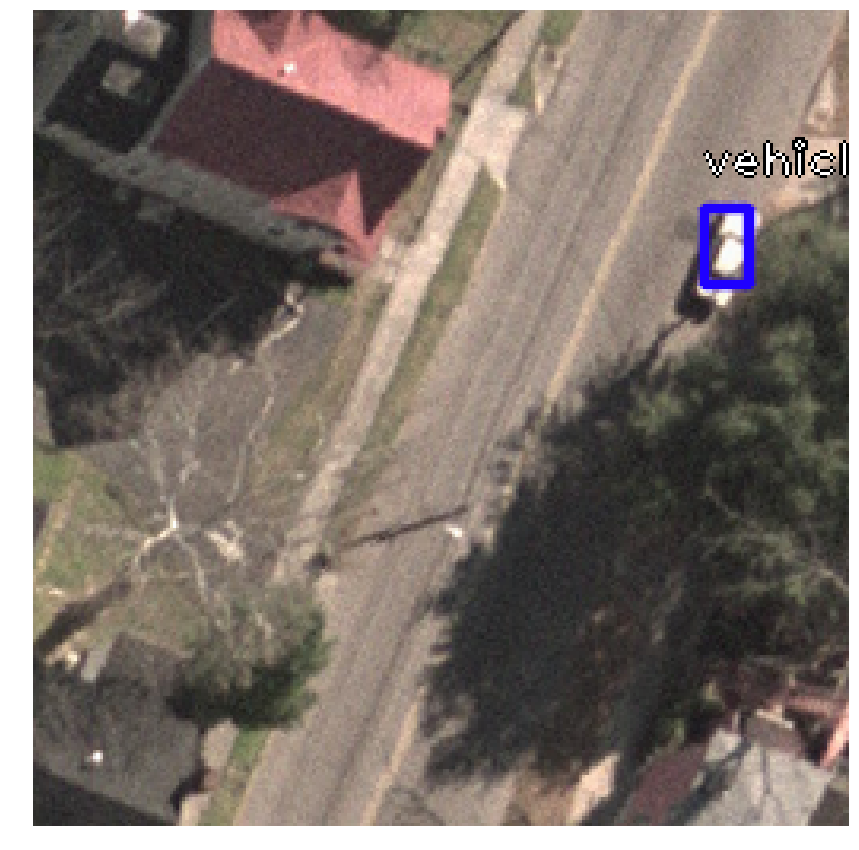

31741696_2561_7681_2817_7937.png
/Users/nomanshafqat/Data/FYP/New/Images_val/31741696_2561_7681_2817_7937.png


processing time:  3.965635061264038


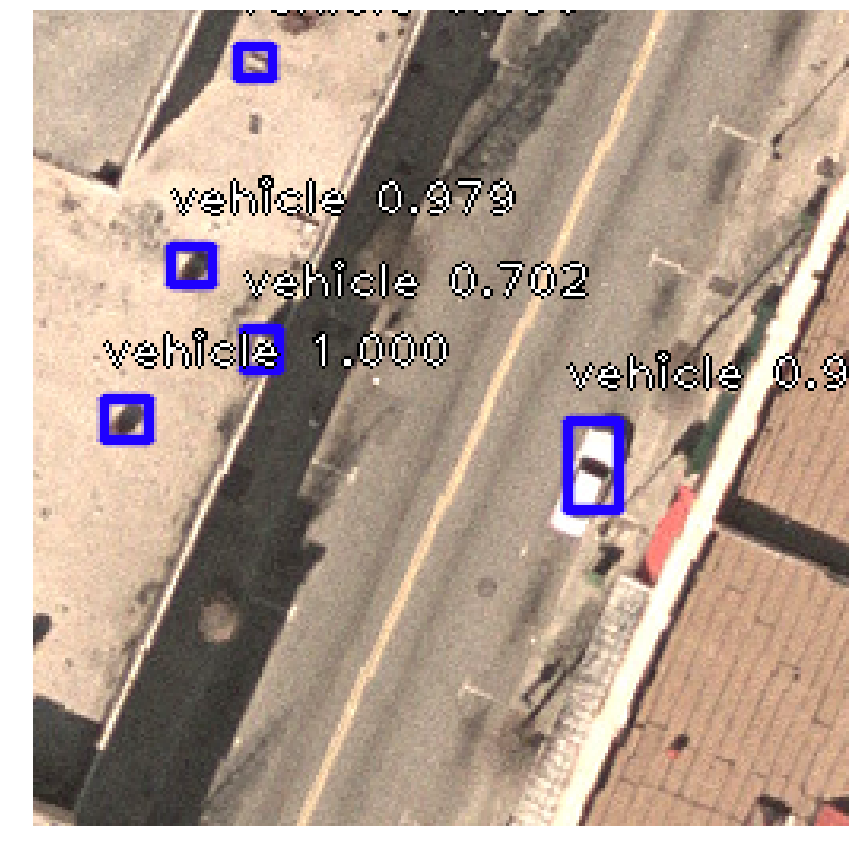

00001119.png
/Users/nomanshafqat/Data/FYP/New/Images_val/00001119.png


processing time:  3.808579683303833


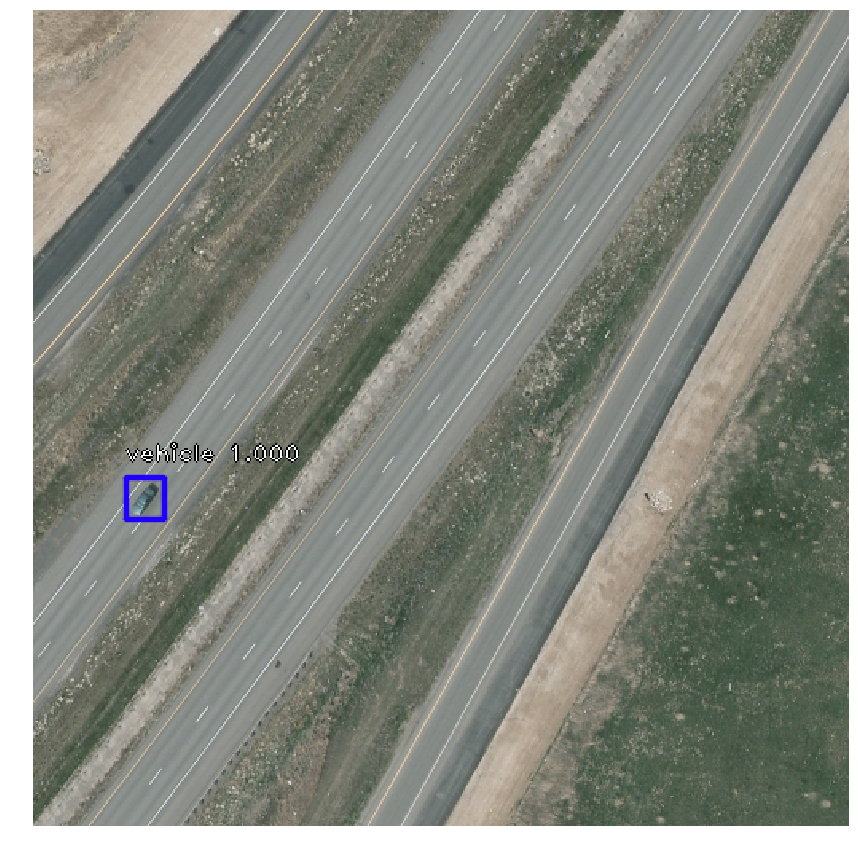

00001125.png
/Users/nomanshafqat/Data/FYP/New/Images_val/00001125.png


processing time:  3.783923864364624


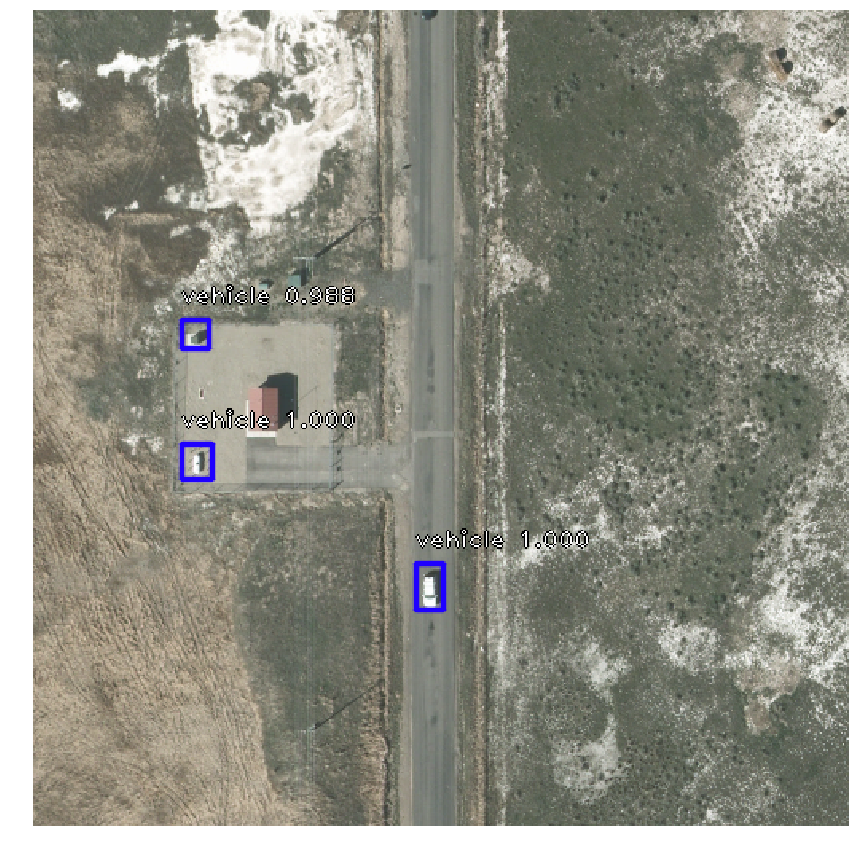

46946744_1281_6657_1537_6913.png
/Users/nomanshafqat/Data/FYP/New/Images_val/46946744_1281_6657_1537_6913.png


processing time:  4.420852899551392


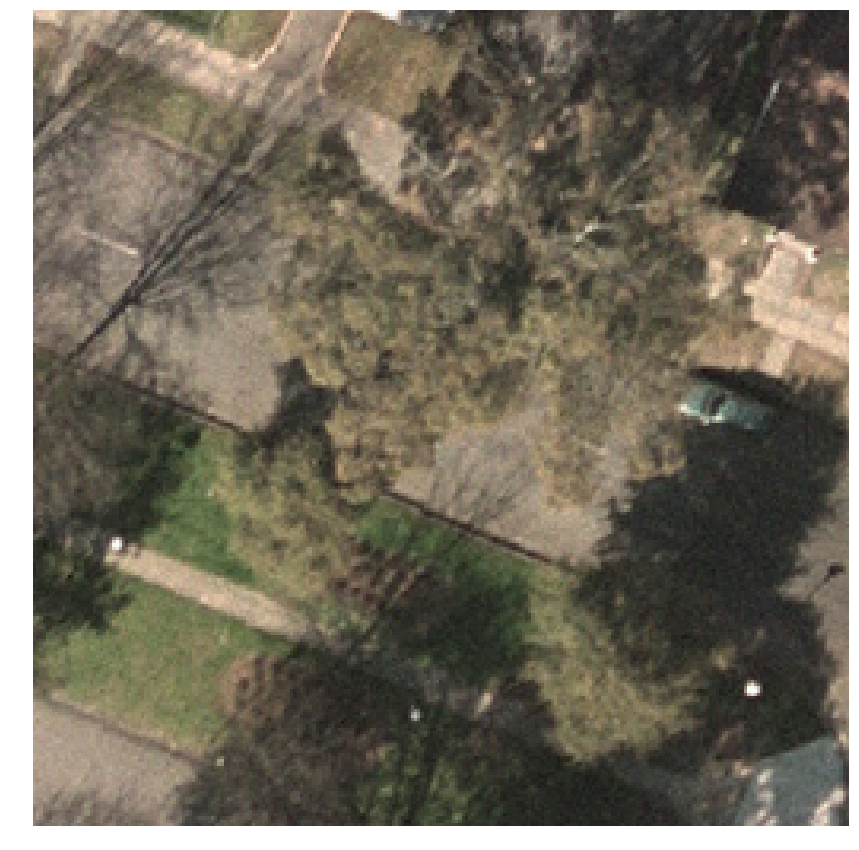

19051500_2817_257_3073_513.png
/Users/nomanshafqat/Data/FYP/New/Images_val/19051500_2817_257_3073_513.png


processing time:  3.8401100635528564


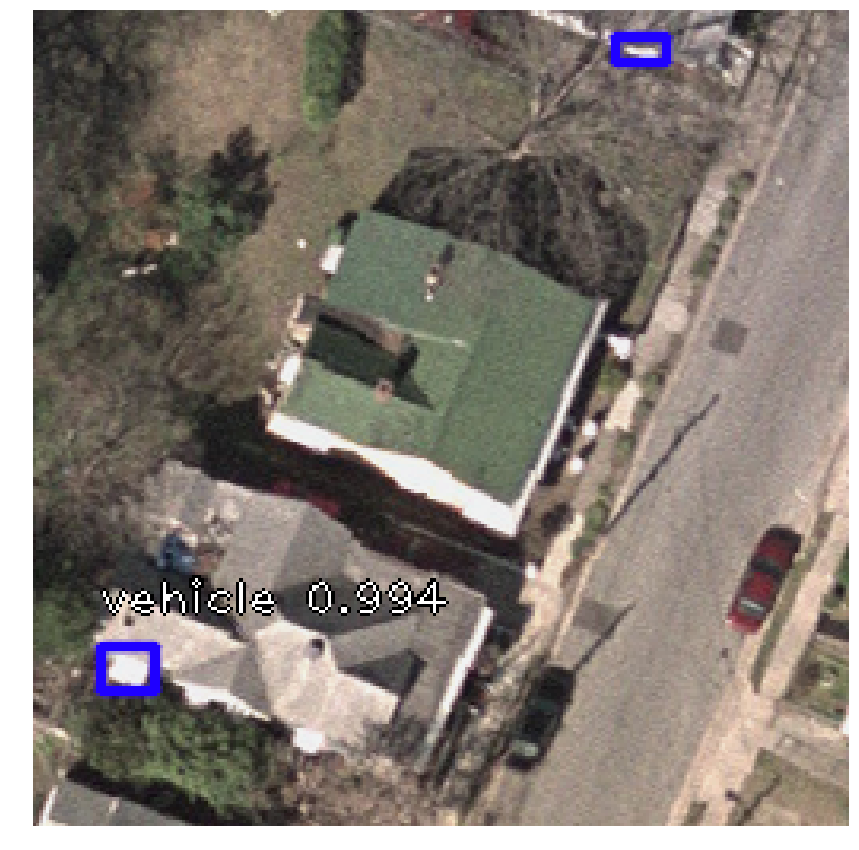

180_46946744_769_4353_1025_4609.png
/Users/nomanshafqat/Data/FYP/New/Images_val/180_46946744_769_4353_1025_4609.png


processing time:  3.796576976776123


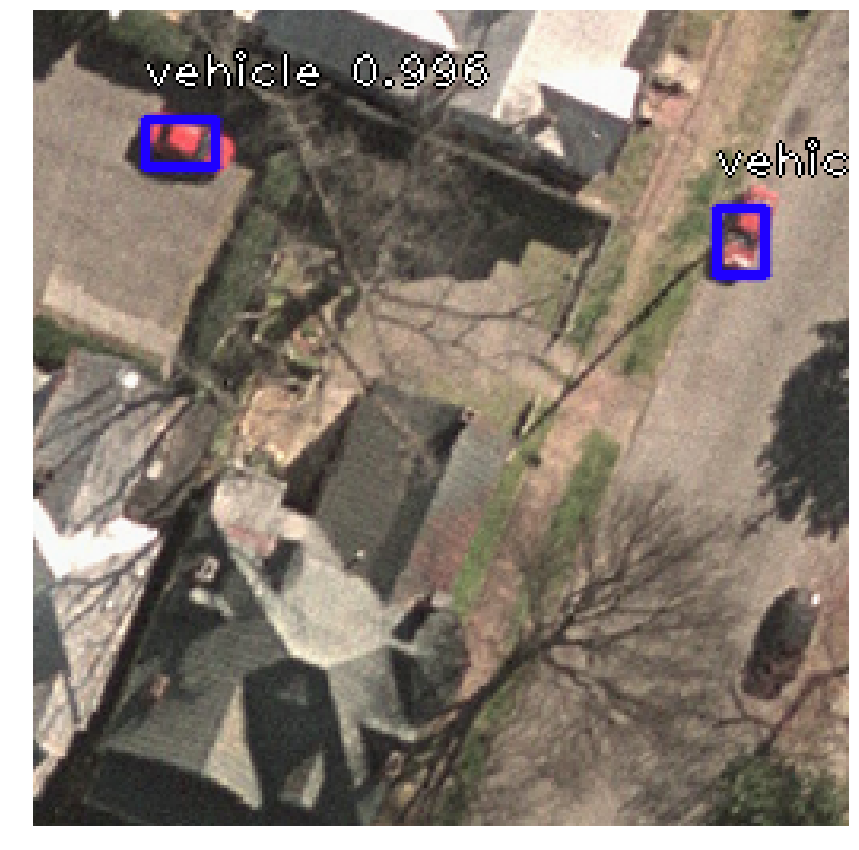

39867435_2561_3073_2817_3329.png
/Users/nomanshafqat/Data/FYP/New/Images_val/39867435_2561_3073_2817_3329.png


processing time:  3.5982491970062256


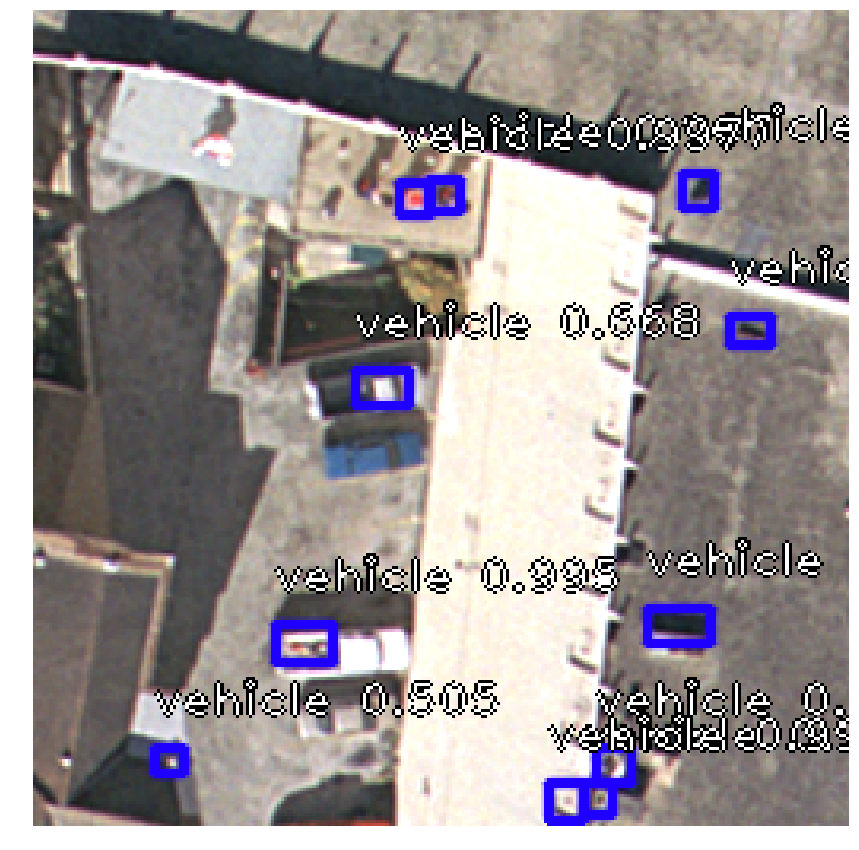

46946744_1281_7937_1537_8193.png
/Users/nomanshafqat/Data/FYP/New/Images_val/46946744_1281_7937_1537_8193.png


processing time:  4.064877033233643


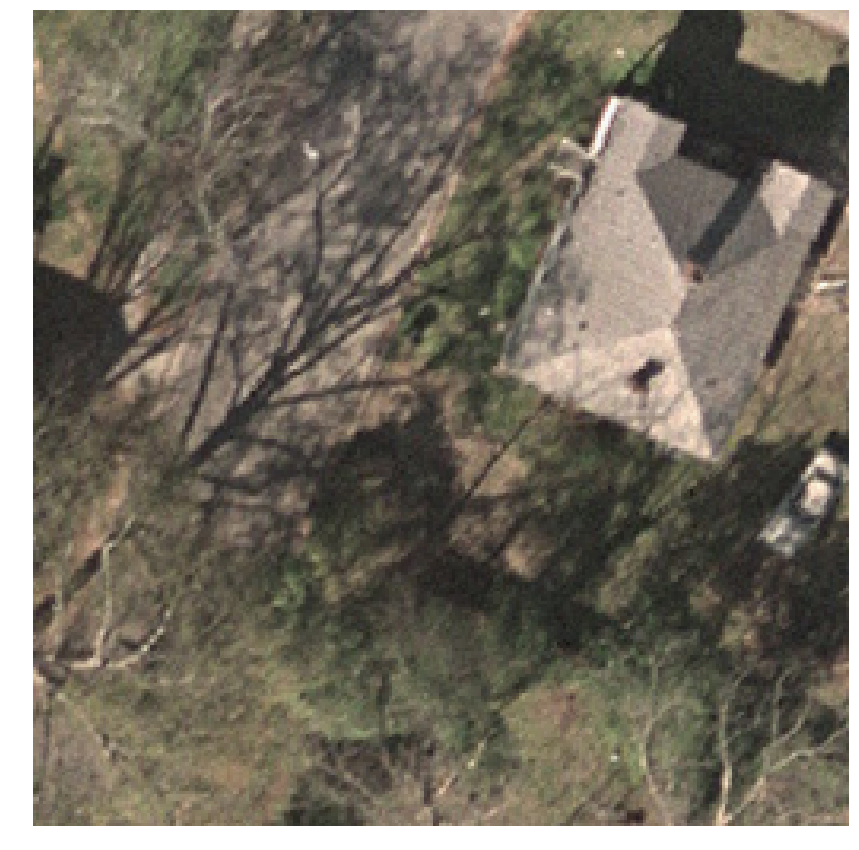

00001127.png
/Users/nomanshafqat/Data/FYP/New/Images_val/00001127.png


processing time:  3.667309045791626


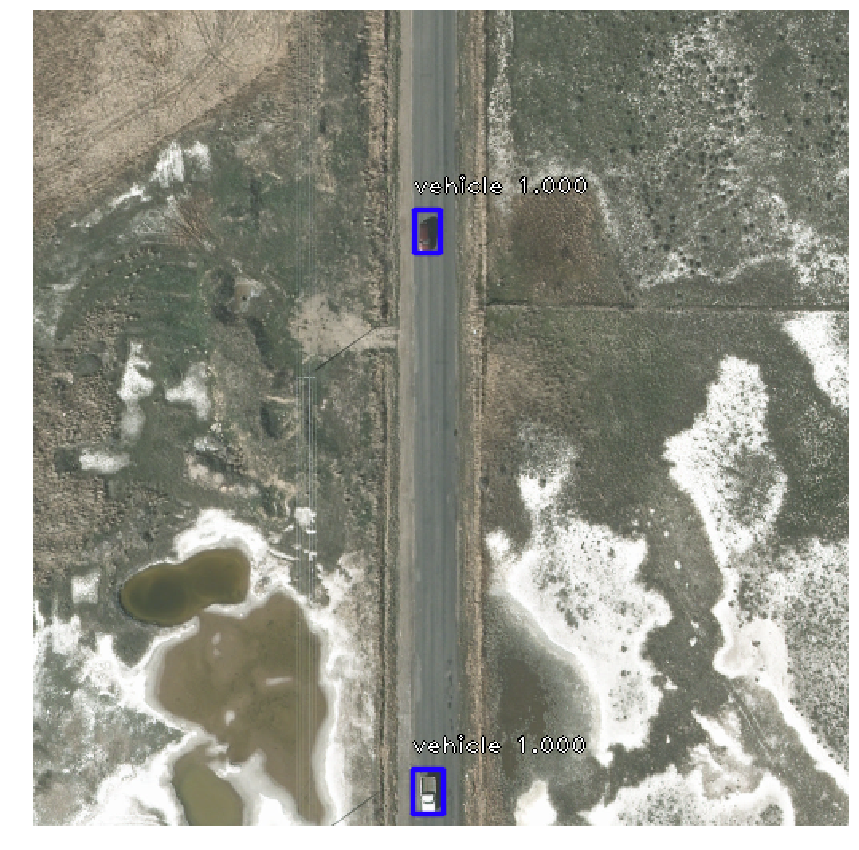

39867435_3073_1_3329_257.png
/Users/nomanshafqat/Data/FYP/New/Images_val/39867435_3073_1_3329_257.png


processing time:  4.503937721252441


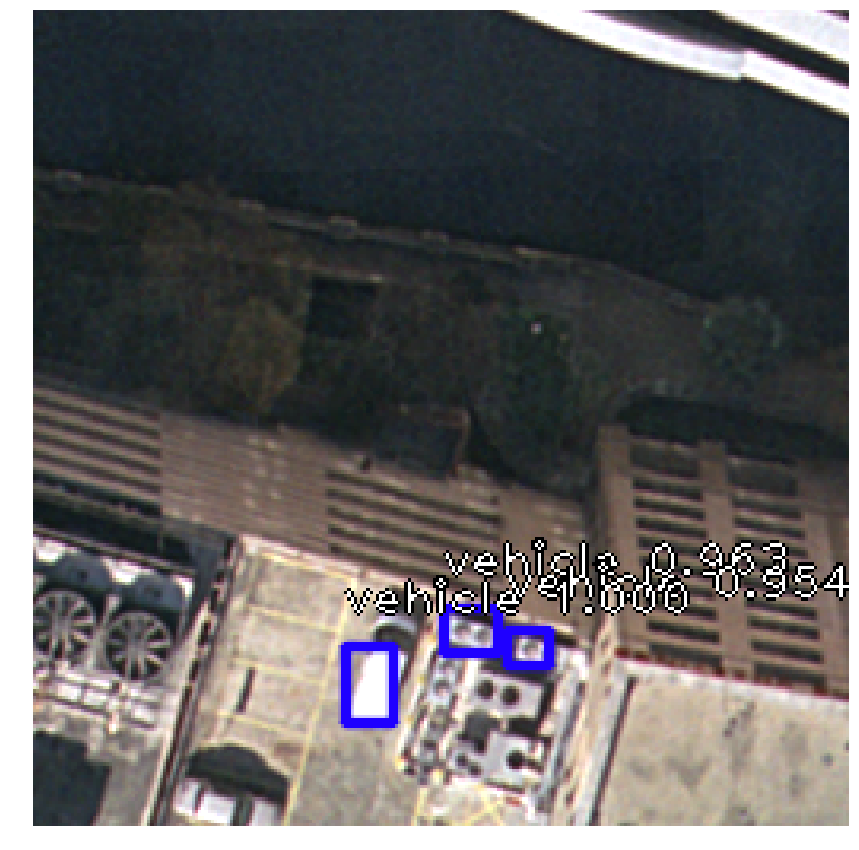

00000007.png
/Users/nomanshafqat/Data/FYP/New/Images_val/00000007.png


processing time:  3.604687213897705


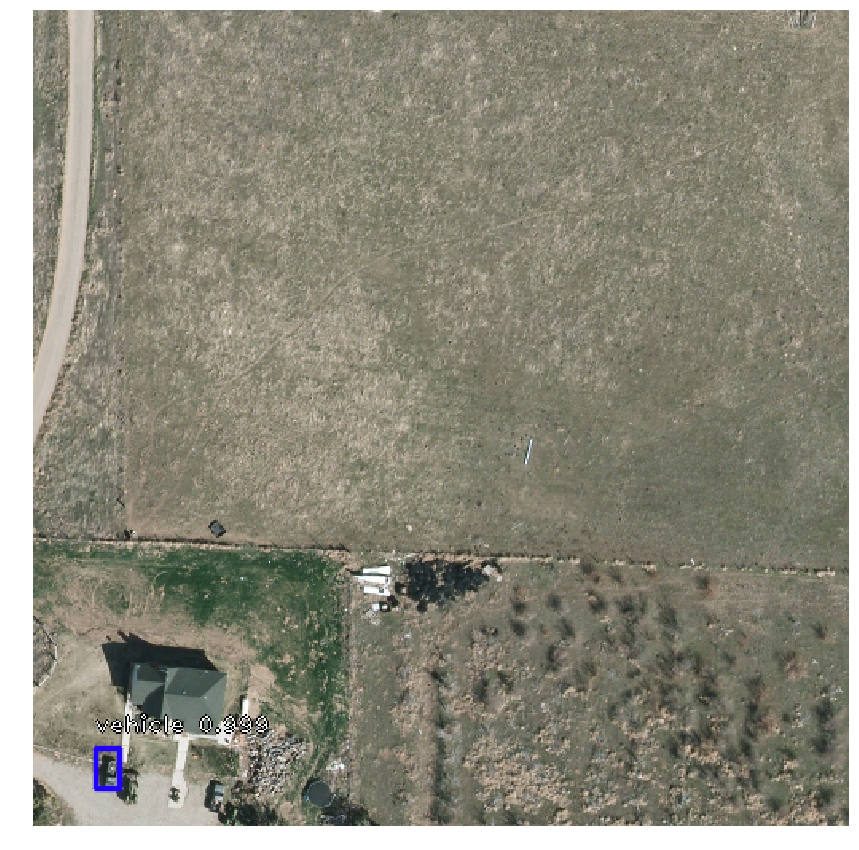

00001126.png
/Users/nomanshafqat/Data/FYP/New/Images_val/00001126.png


processing time:  4.078419923782349


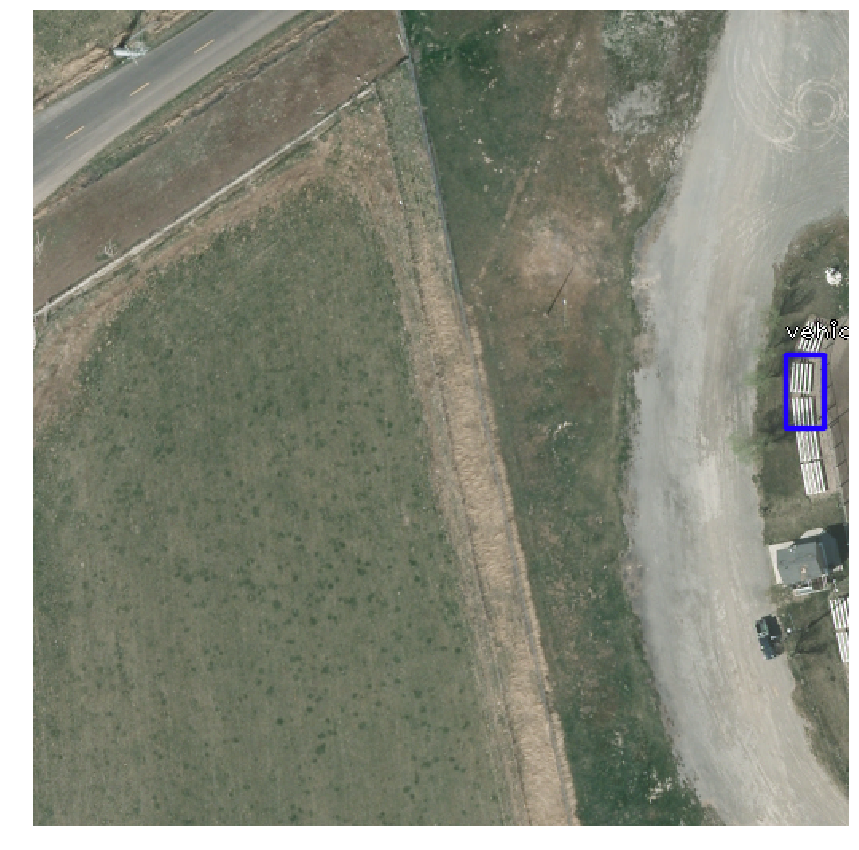

19051500_2561_257_2817_513.png
/Users/nomanshafqat/Data/FYP/New/Images_val/19051500_2561_257_2817_513.png


processing time:  3.6500930786132812


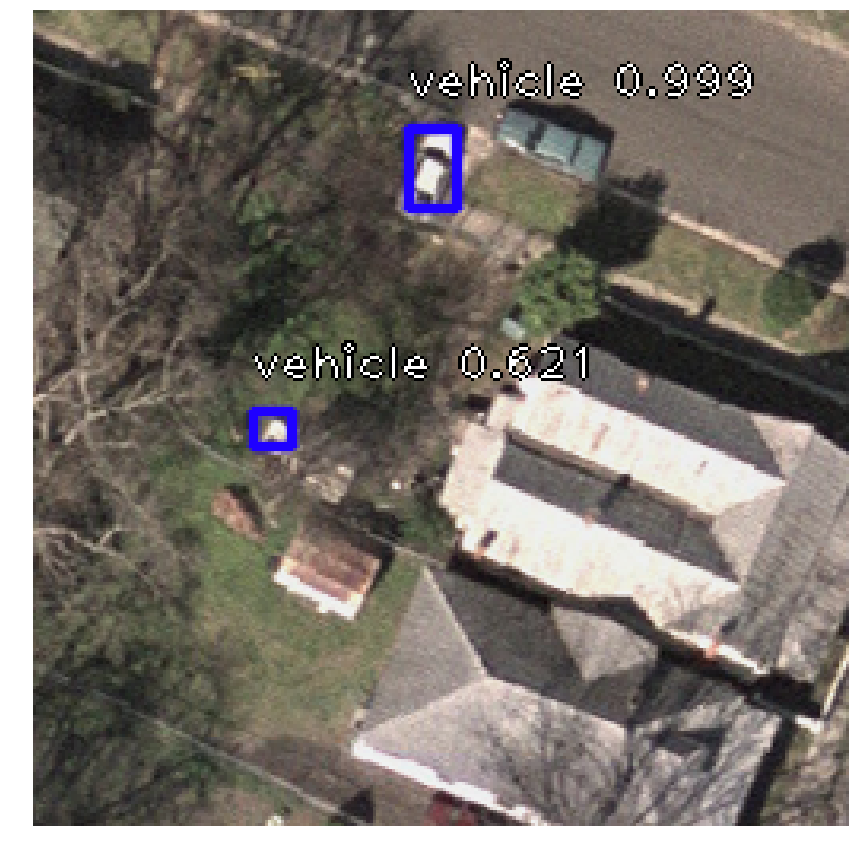

90_00000468.png
/Users/nomanshafqat/Data/FYP/New/Images_val/90_00000468.png


processing time:  4.057718992233276


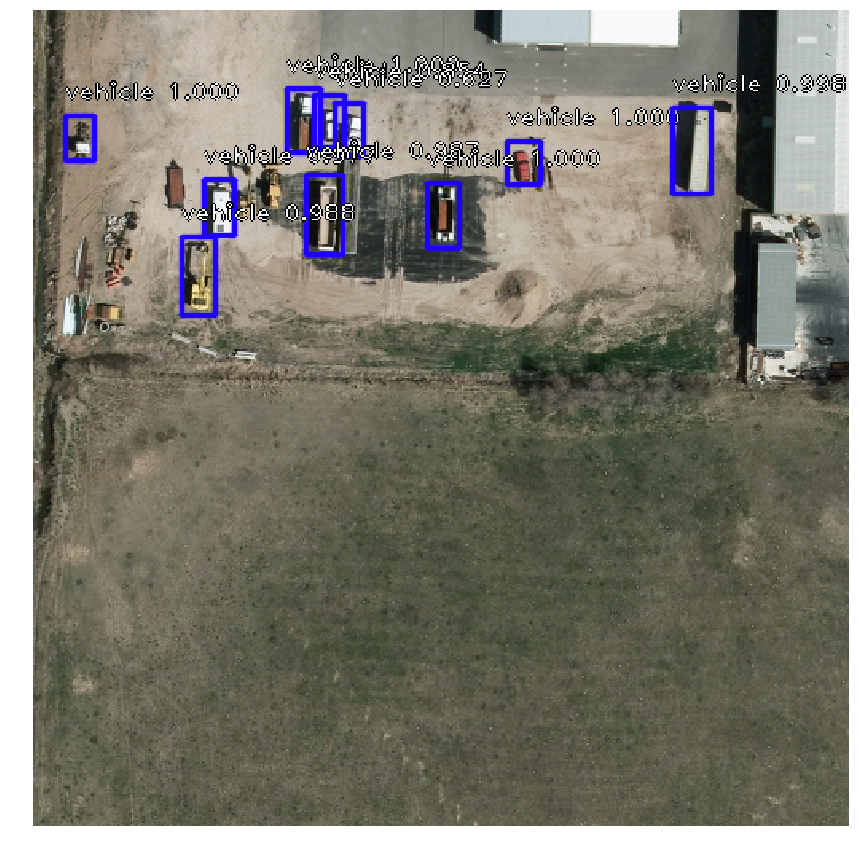

31741696_2305_513_2561_769.png
/Users/nomanshafqat/Data/FYP/New/Images_val/31741696_2305_513_2561_769.png


processing time:  3.6397831439971924


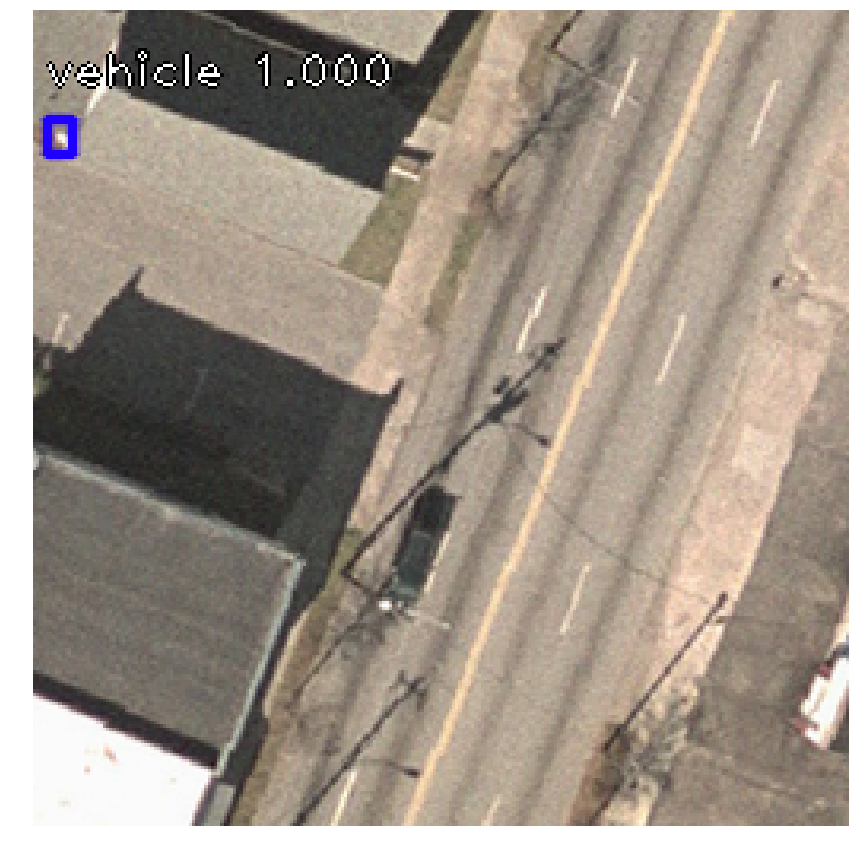

46946744_1281_5121_1537_5377.png
/Users/nomanshafqat/Data/FYP/New/Images_val/46946744_1281_5121_1537_5377.png


processing time:  4.009270668029785


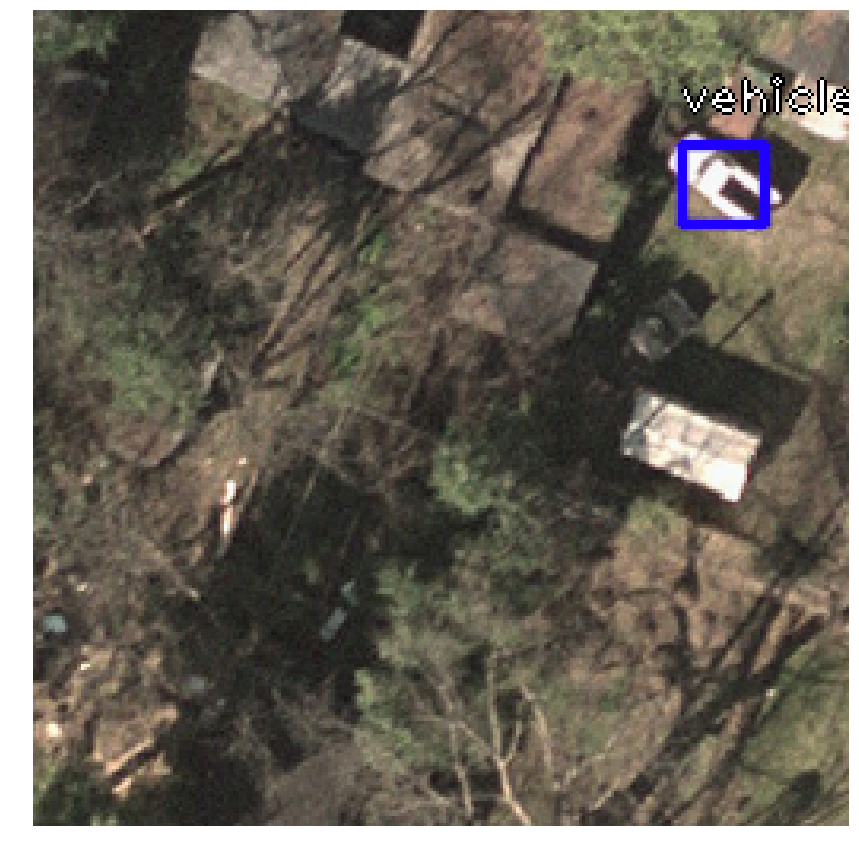

19051500_2817_3585_3073_3841.png
/Users/nomanshafqat/Data/FYP/New/Images_val/19051500_2817_3585_3073_3841.png


processing time:  4.148191928863525


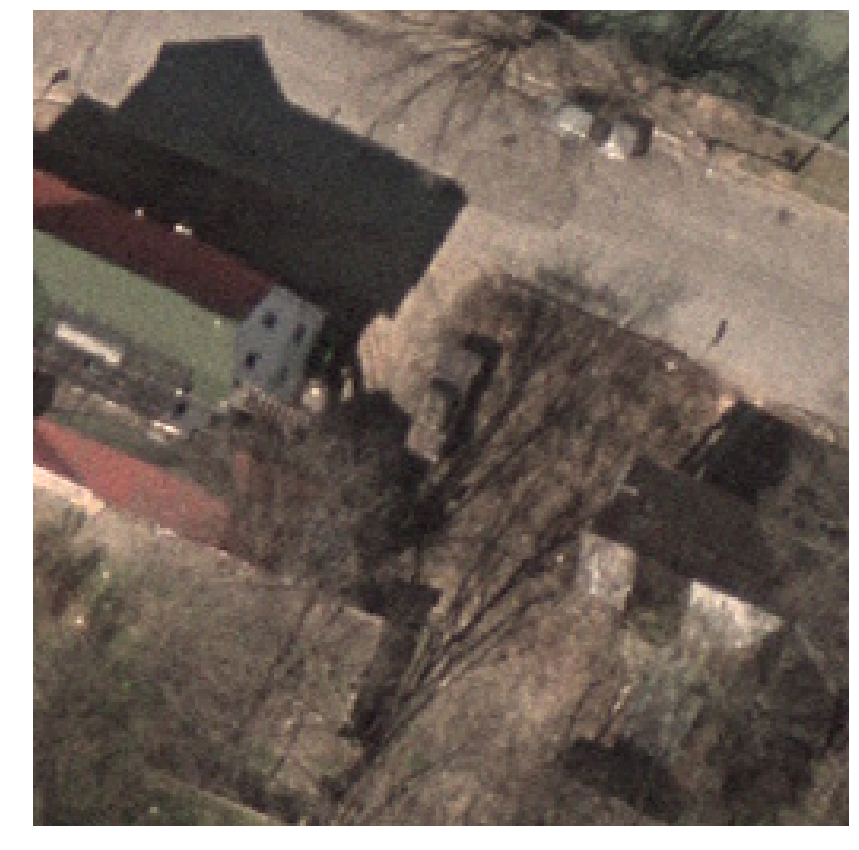

00001122.png
/Users/nomanshafqat/Data/FYP/New/Images_val/00001122.png


processing time:  4.227221965789795


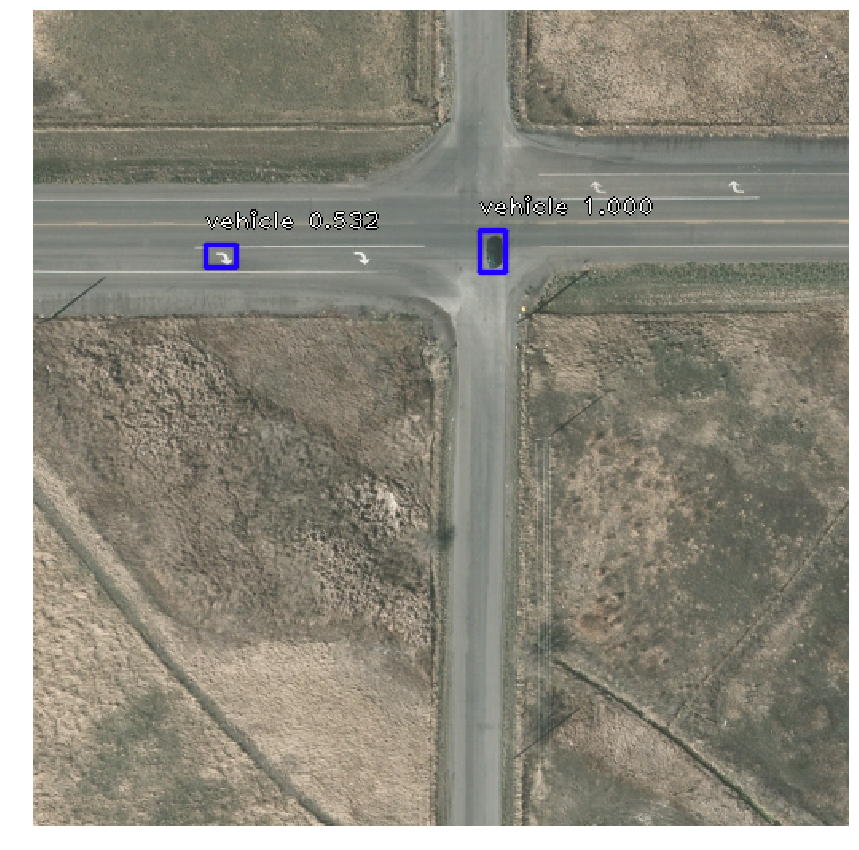

56924123_1_2049_257_2305.png
/Users/nomanshafqat/Data/FYP/New/Images_val/56924123_1_2049_257_2305.png


processing time:  4.38048791885376


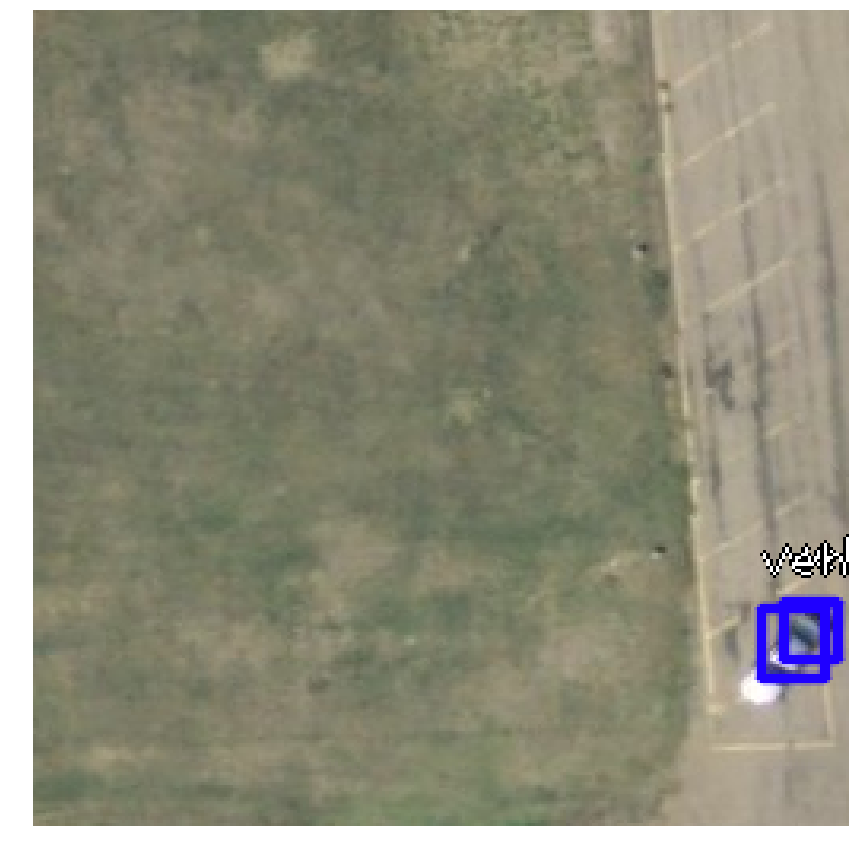

00001123.png
/Users/nomanshafqat/Data/FYP/New/Images_val/00001123.png


processing time:  4.000607252120972


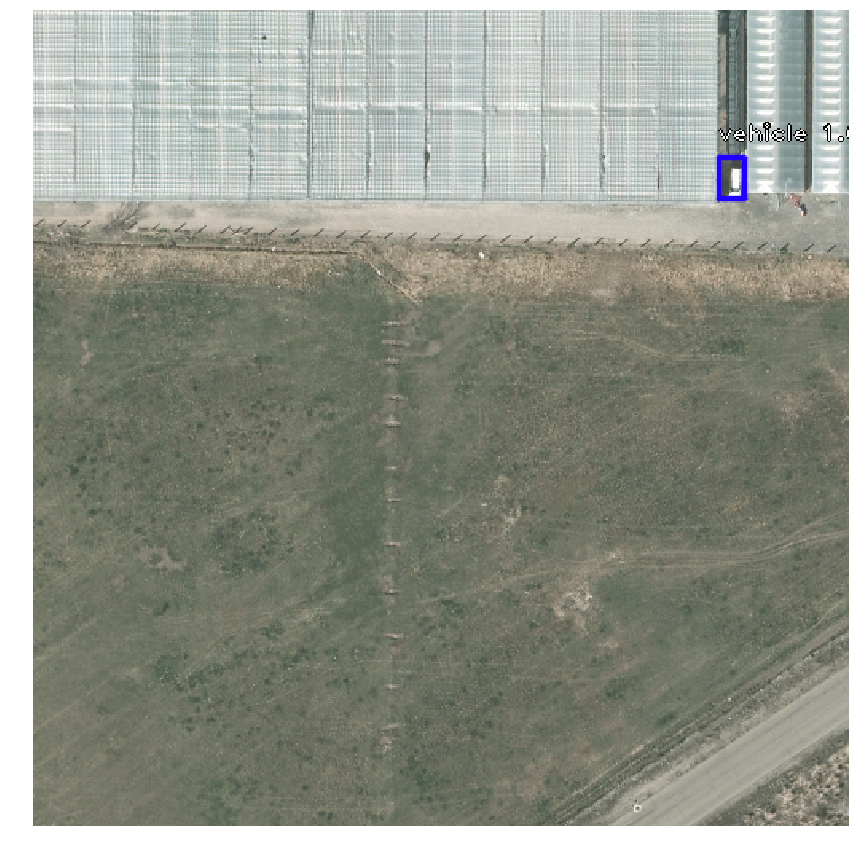

31741696_2561_769_2817_1025.png
/Users/nomanshafqat/Data/FYP/New/Images_val/31741696_2561_769_2817_1025.png


processing time:  4.134997844696045


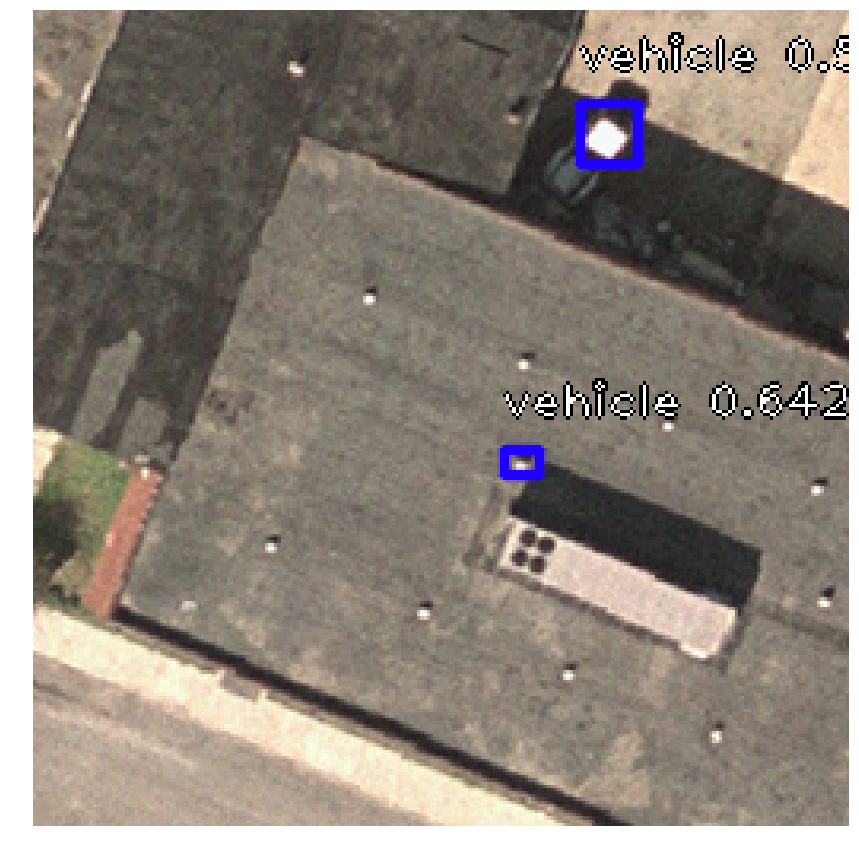

56924123_1281_4353_1537_4609.png
/Users/nomanshafqat/Data/FYP/New/Images_val/56924123_1281_4353_1537_4609.png


processing time:  4.217768907546997


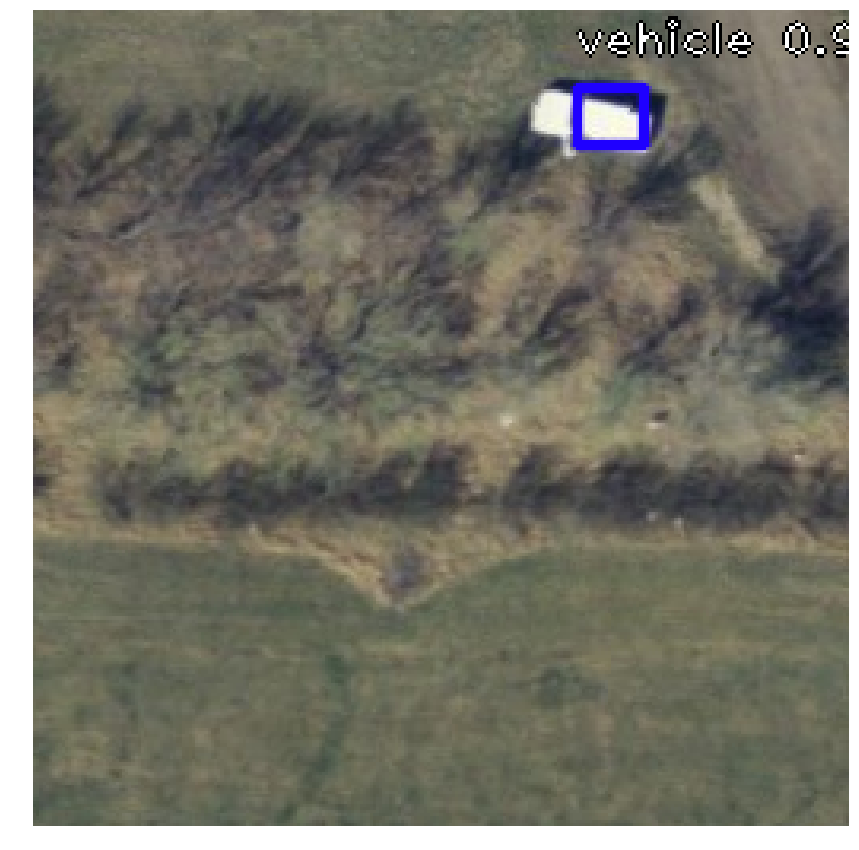

19051500_2561_5889_2817_6145.png
/Users/nomanshafqat/Data/FYP/New/Images_val/19051500_2561_5889_2817_6145.png


processing time:  4.17301082611084


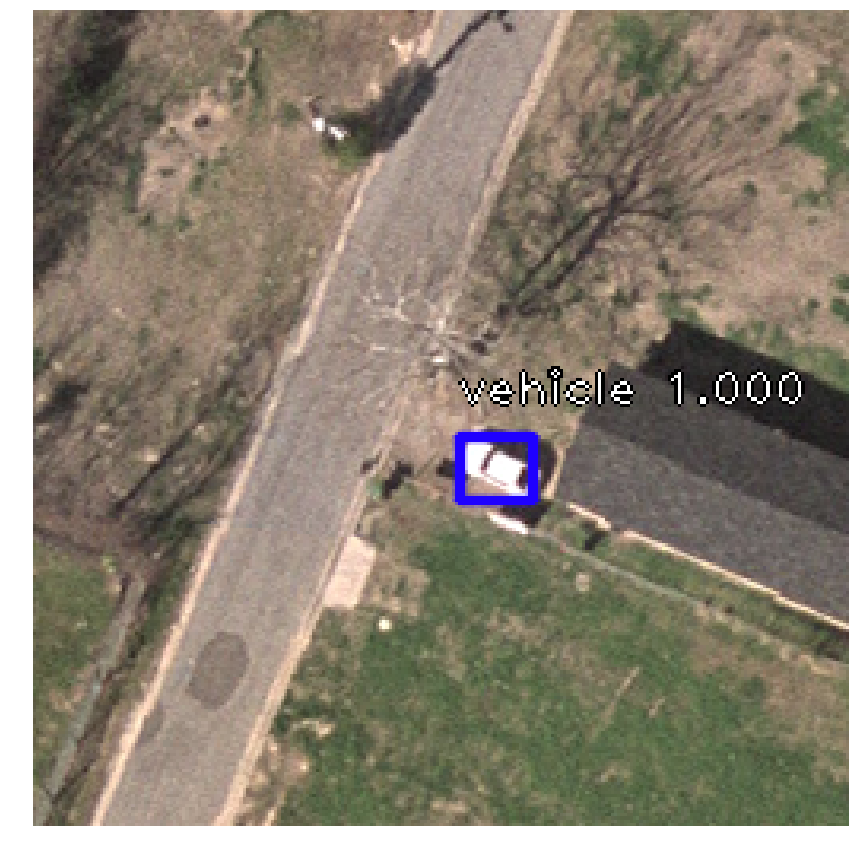

00001121.png
/Users/nomanshafqat/Data/FYP/New/Images_val/00001121.png


processing time:  4.010895729064941


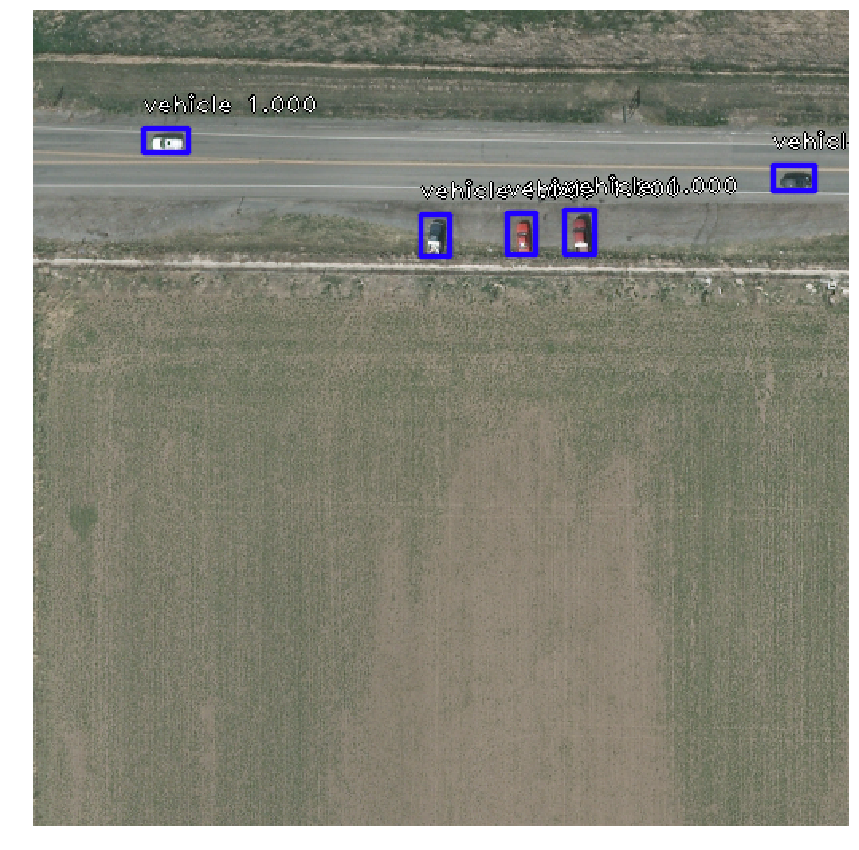

00001120.png
/Users/nomanshafqat/Data/FYP/New/Images_val/00001120.png


processing time:  3.635283946990967


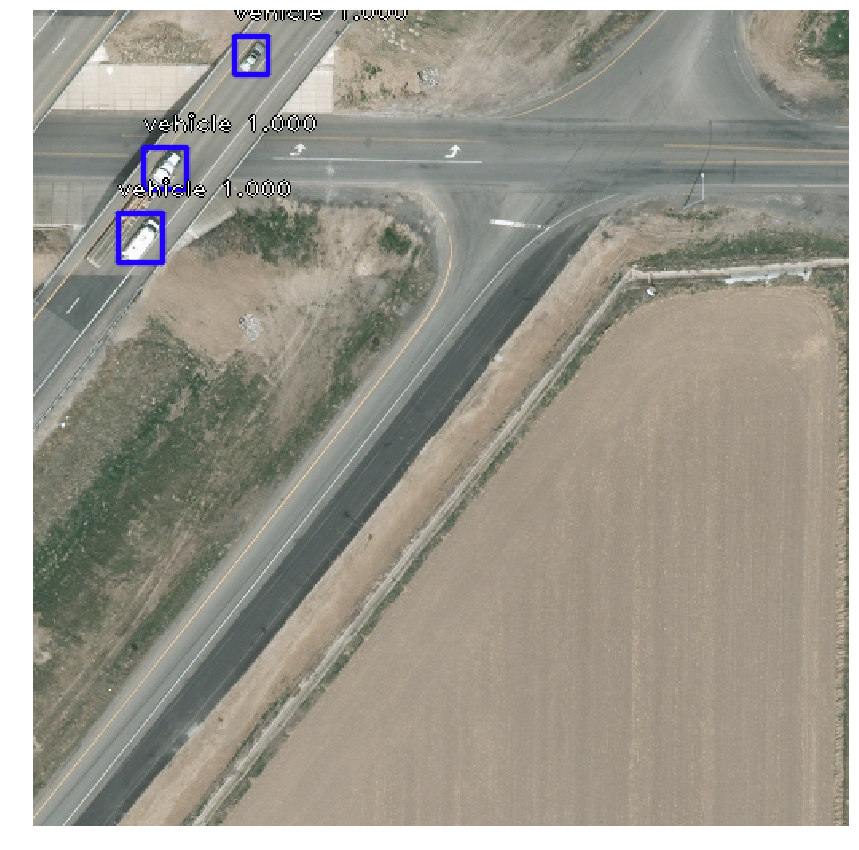

46946744_1281_8449_1537_8705.png
/Users/nomanshafqat/Data/FYP/New/Images_val/46946744_1281_8449_1537_8705.png


processing time:  4.003352165222168


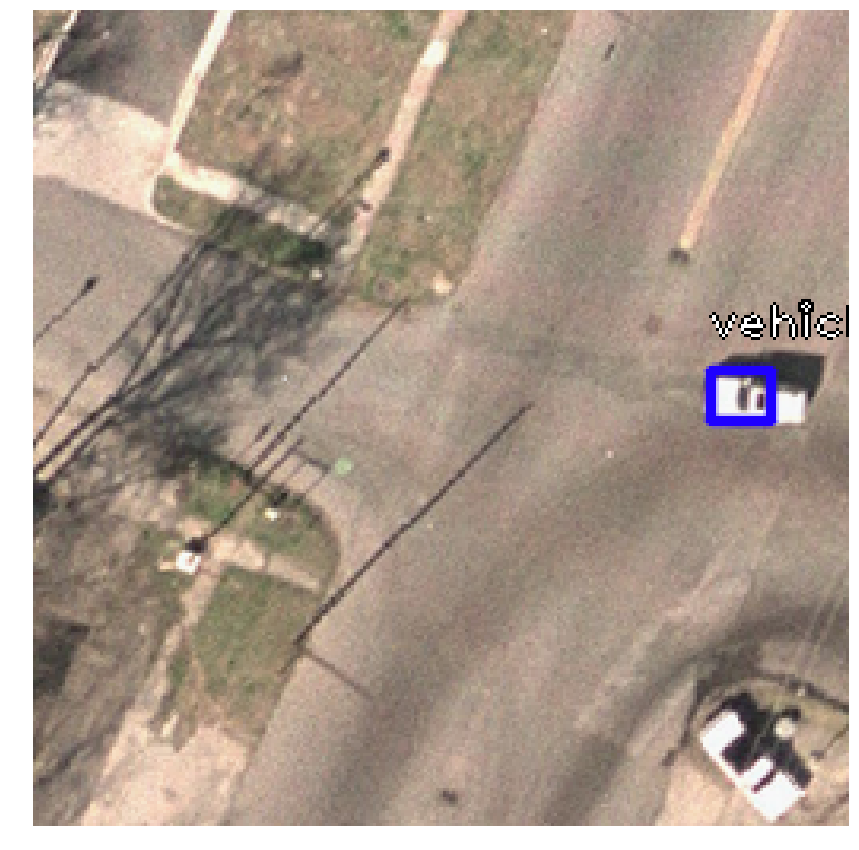

31741696_2561_7169_2817_7425.png
/Users/nomanshafqat/Data/FYP/New/Images_val/31741696_2561_7169_2817_7425.png


processing time:  4.030047178268433


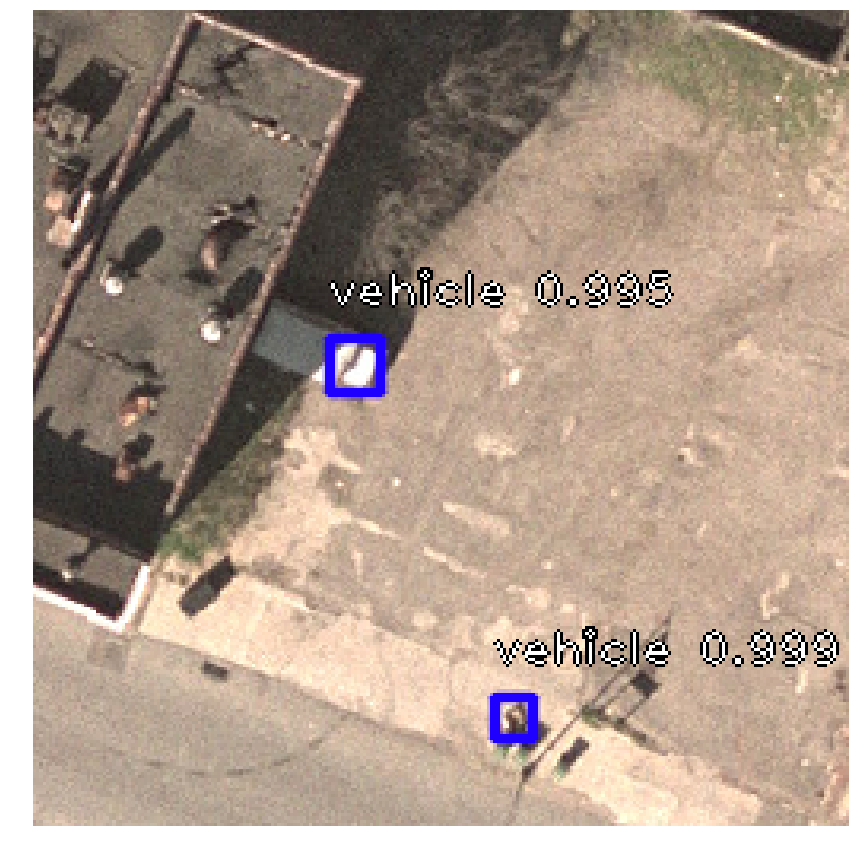

90_00000743.png
/Users/nomanshafqat/Data/FYP/New/Images_val/90_00000743.png


processing time:  3.7866439819335938


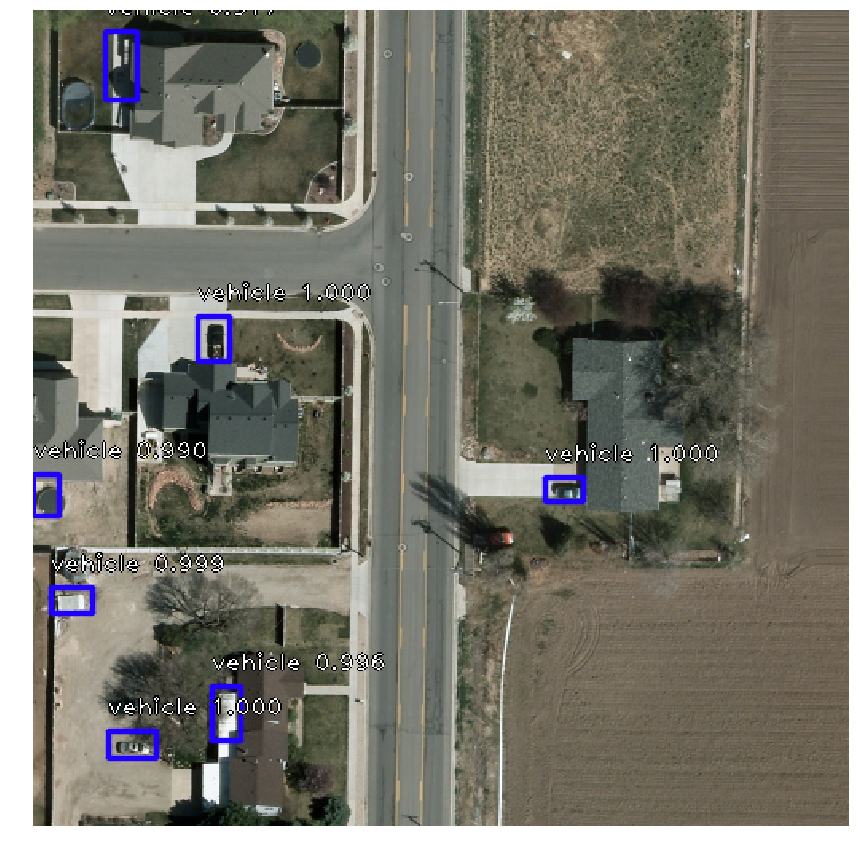

90_00000742.png
/Users/nomanshafqat/Data/FYP/New/Images_val/90_00000742.png


processing time:  3.6731197834014893


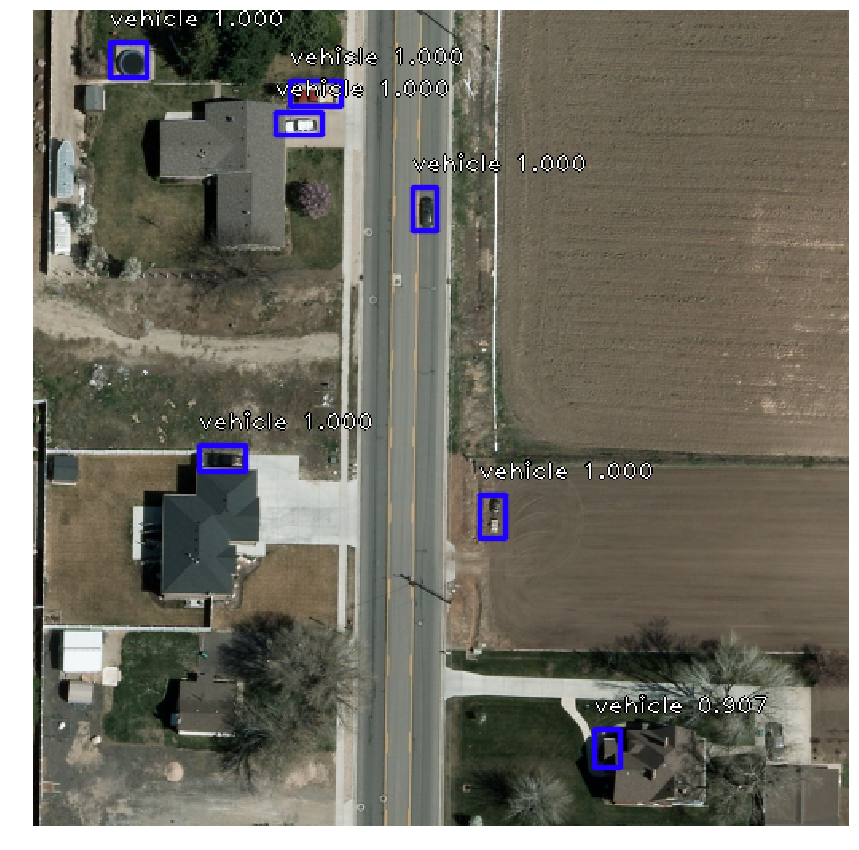

46946744_1793_5633_2049_5889.png
/Users/nomanshafqat/Data/FYP/New/Images_val/46946744_1793_5633_2049_5889.png


processing time:  3.735962152481079


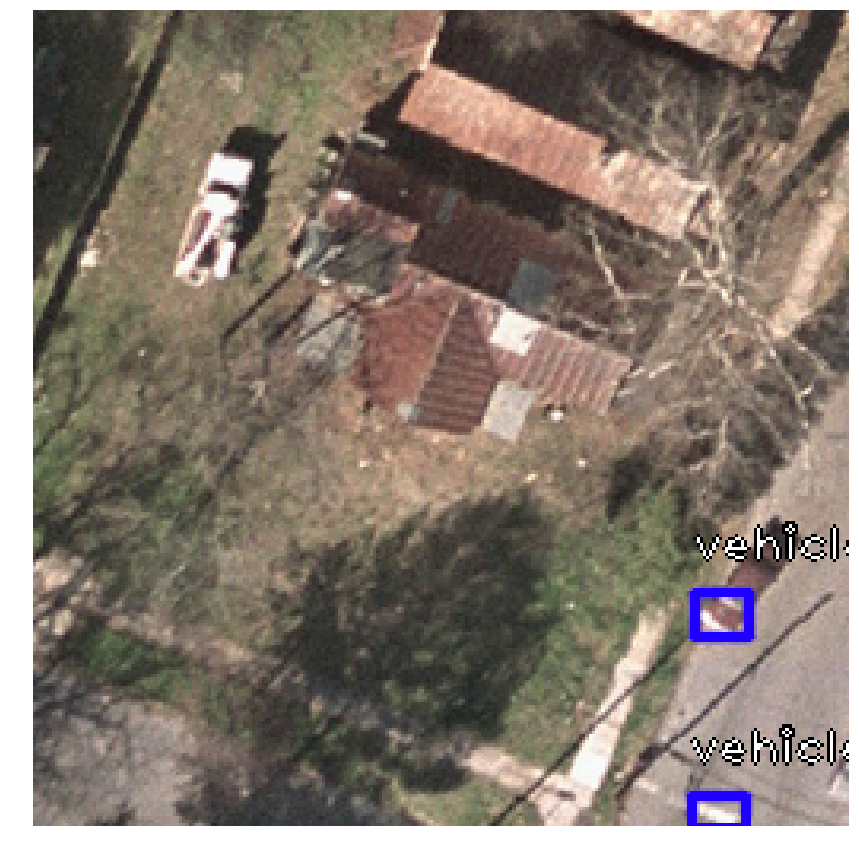

46946744_1793_6401_2049_6657.png
/Users/nomanshafqat/Data/FYP/New/Images_val/46946744_1793_6401_2049_6657.png


processing time:  3.7106480598449707


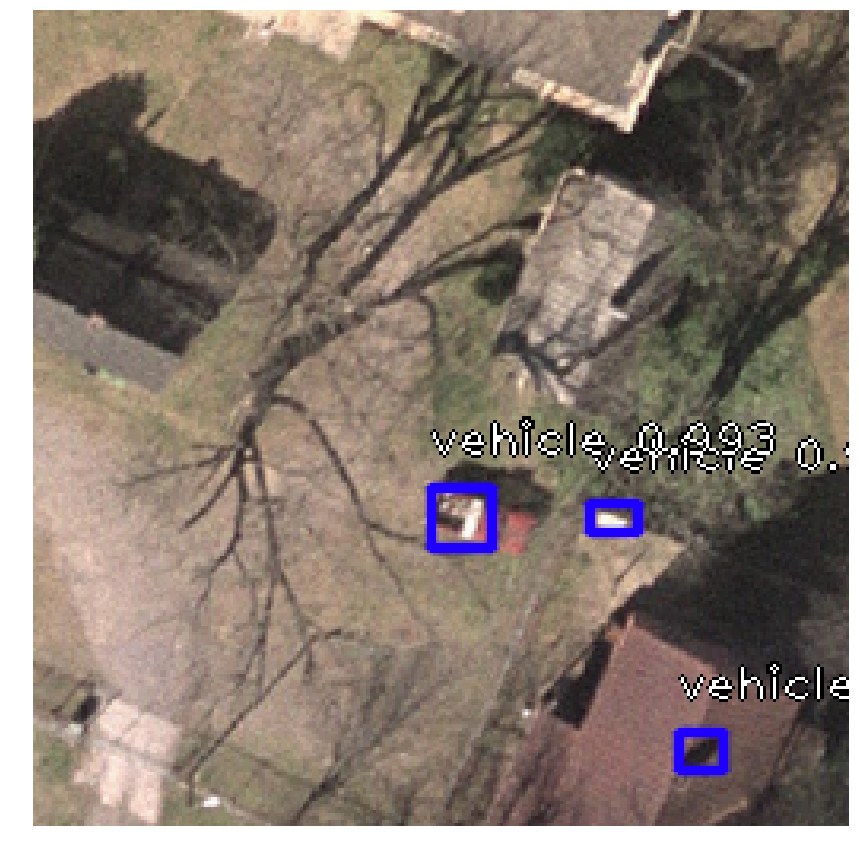

56924123_3841_513_4097_769.png
/Users/nomanshafqat/Data/FYP/New/Images_val/56924123_3841_513_4097_769.png


processing time:  4.195592164993286


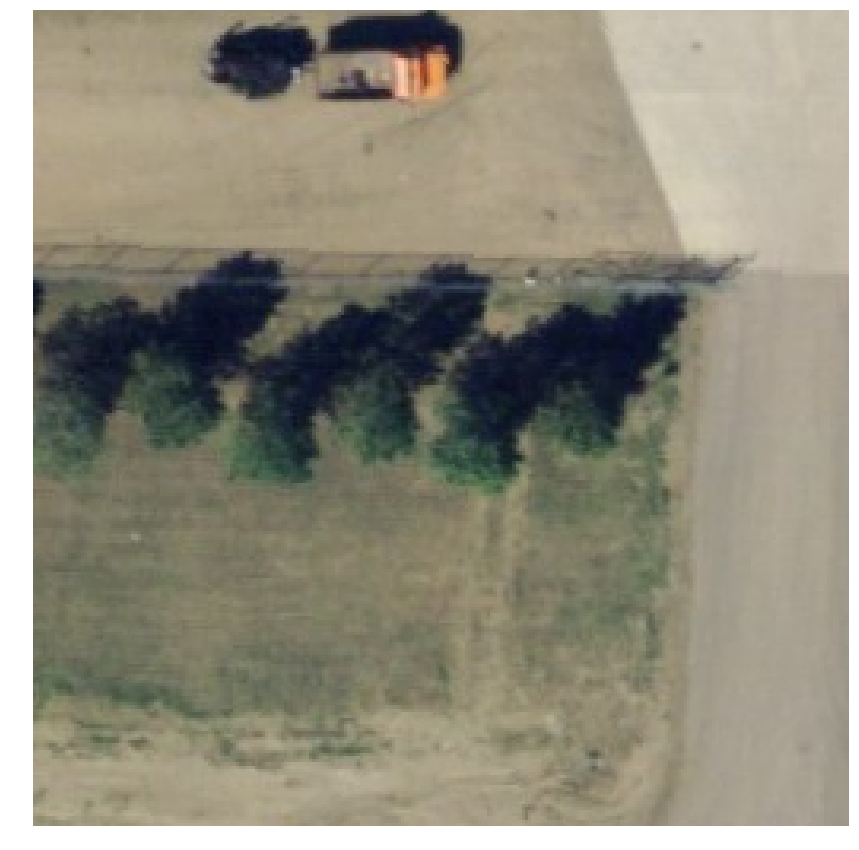

19051500_2561_1025_2817_1281.png
/Users/nomanshafqat/Data/FYP/New/Images_val/19051500_2561_1025_2817_1281.png


processing time:  3.7856690883636475


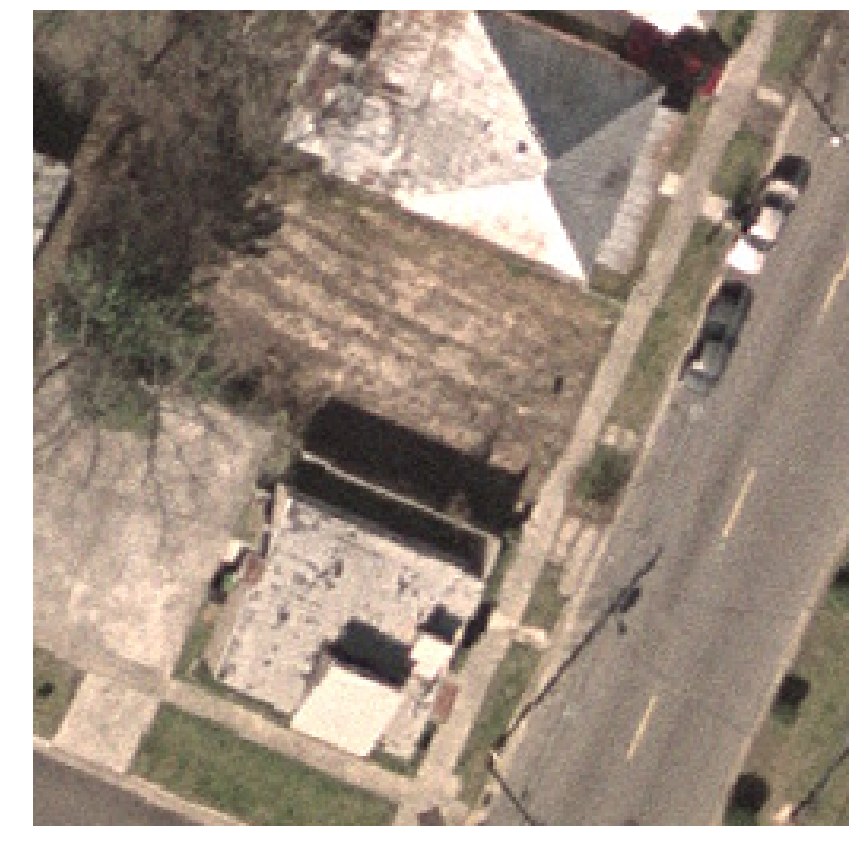

270_MunichStreet03MOS94.png
/Users/nomanshafqat/Data/FYP/New/Images_val/270_MunichStreet03MOS94.png


processing time:  2.7719860076904297


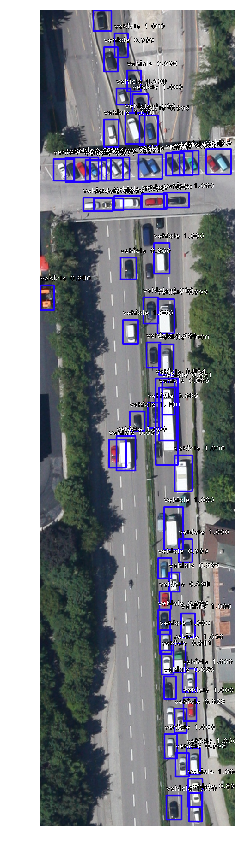

00001019.png
/Users/nomanshafqat/Data/FYP/New/Images_val/00001019.png


processing time:  4.529705047607422


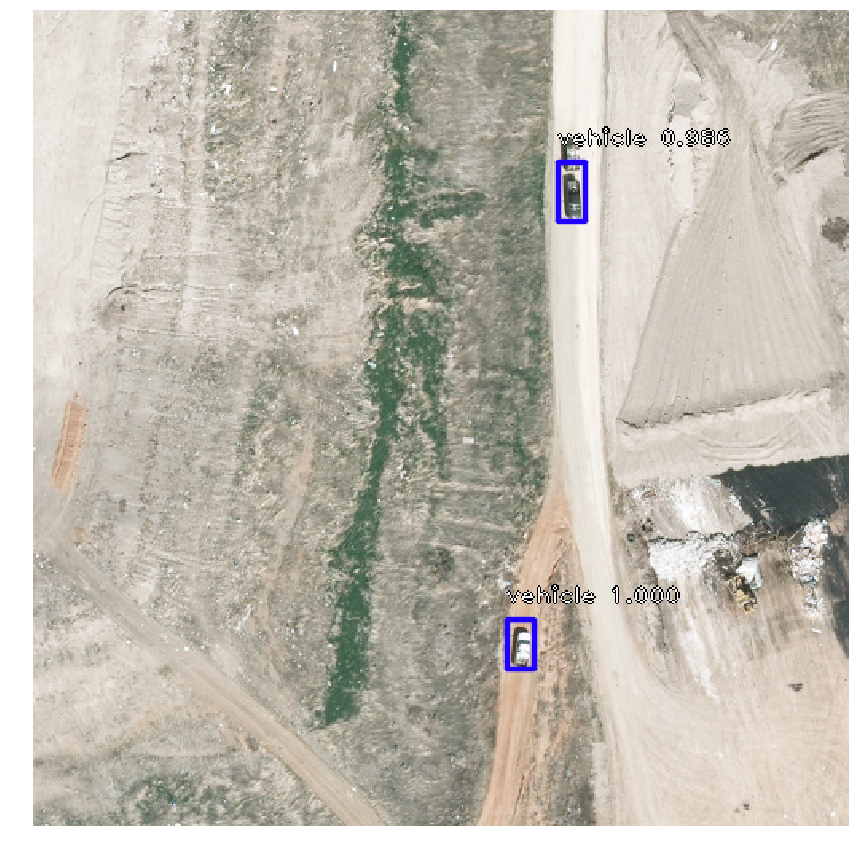

19051500_2817_513_3073_769.png
/Users/nomanshafqat/Data/FYP/New/Images_val/19051500_2817_513_3073_769.png


processing time:  3.7952349185943604


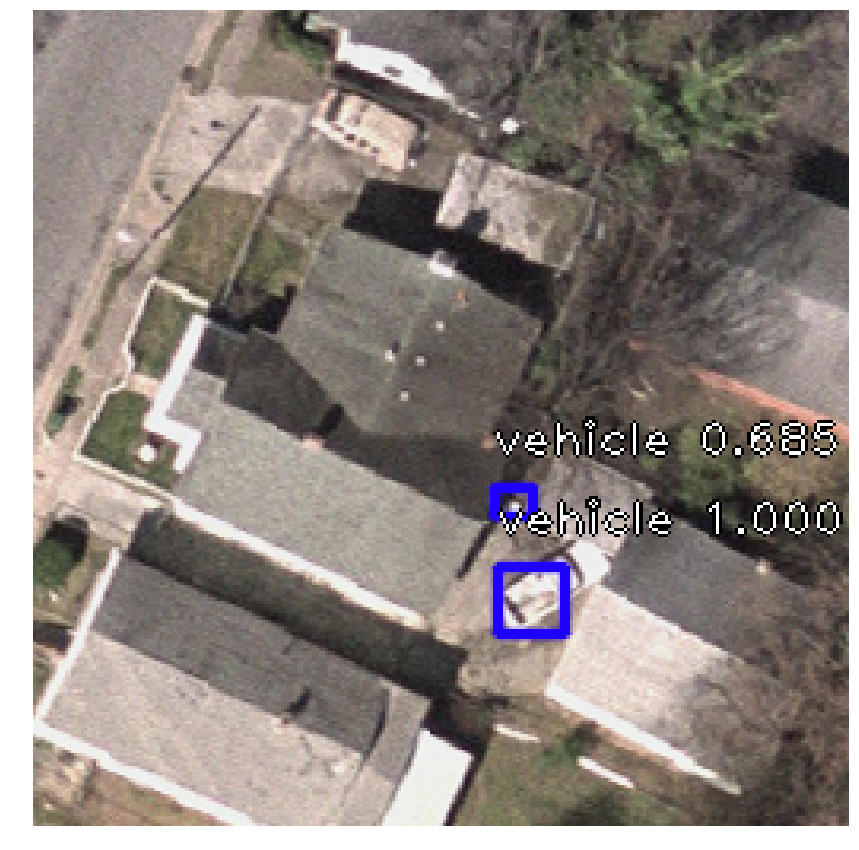

90_00000744.png
/Users/nomanshafqat/Data/FYP/New/Images_val/90_00000744.png


KeyboardInterrupt: 

In [14]:

dir="/Users/nomanshafqat/Data/FYP/New/Images_val/"


list = os.listdir(dir)

for image in list:
    if image == ".DS_Store":
        continue
    print(image)
    #imgcv = cv2.imread(os.path.join(dir, image))
    
    fullpath=os.path.join(dir, image)
    print (fullpath)
    # load image
    image = read_image_bgr(fullpath)
    
    # copy to draw on
    draw = image.copy()
    draw = cv2.cvtColor(draw, cv2.COLOR_BGR2RGB)
    
    # preprocess image for network
    image = preprocess_image(image)
    image, scale = resize_image(image)
    
    # process image
    start = time.time()
    _, _, boxes, nms_classification = model.predict_on_batch(np.expand_dims(image, axis=0))
    print("processing time: ", time.time() - start)
    
    # compute predicted labels and scores
    predicted_labels = np.argmax(nms_classification[0, :, :], axis=1)
    scores = nms_classification[0, np.arange(nms_classification.shape[1]), predicted_labels]
    
    # correct for image scale
    boxes /= scale
    
    # visualize detections
    for idx, (label, score) in enumerate(zip(predicted_labels, scores)):
        if score < 0.5:
            continue
            
        color = label_color(label)
    
        b = boxes[0, idx, :].astype(int)
        draw_box(draw, b, color=color)
        
        caption = "{} {:.3f}".format(labels_to_names[label], score)
        draw_caption(draw, b, caption)
        
    plt.figure(figsize=(15, 15))
    plt.axis('off')
    plt.imshow(draw)
    plt.show()